In [1]:
# Install pip packages in the current Jupyter kernel
import sys
!{sys.executable} -m pip install tensorflow
!{sys.executable} -m pip install matplotlib

  Obtaining dependency information for matplotlib from https://files.pythonhosted.org/packages/b4/c2/f74e0deb26379aead0956a6ecf9acd4587debba0c7abe4bd8fe53fe04ec2/matplotlib-3.7.2-cp38-cp38-manylinux_2_12_x86_64.manylinux2010_x86_64.whl.metadata
  Obtaining dependency information for contourpy>=1.0.1 from https://files.pythonhosted.org/packages/32/c8/aa9e87941002150b1a8e7087e48da1c76290268b9fdfa3034a98a5806198/contourpy-1.1.0-cp38-cp38-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata
  Obtaining dependency information for fonttools>=4.22.0 from https://files.pythonhosted.org/packages/91/f1/2379b341206a6e7e12f9d7c406ea03f0e0386eafa7913a47d8cc931cacf4/fonttools-4.42.1-cp38-cp38-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 151.0/151.0 kB 2.7 MB/s eta 0:00:00a 0:00:01
  Obtaining dependency information for kiwisolver>=1.0.1 from https://files.pythonhosted.org/packages/d2/55/7021ffcc8cb26a520bb051aa0a3d08daf200cde945e5863d5768161

In [8]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt

# Load the model from the disk

In [3]:
model = tf.keras.models.load_model('./models/1')

2023-09-02 22:12:20.560486: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2023-09-02 22:12:20.597088: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2023-09-02 22:12:20.597463: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2023-09-02 22:12:20.600016: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2023-09-02 22:12:20.600380: I tensorflow/compile

# Constants and data

In [5]:
IMAGE_SIZE = 256
BATCH_SIZE = 32
CHANNELS = 3  # The RGB channels
EPOCHS = 50

In [6]:
dataset = tf.keras.preprocessing.image_dataset_from_directory(
    "data",
    shuffle=True,
    image_size=(IMAGE_SIZE, IMAGE_SIZE),
    batch_size=BATCH_SIZE    
)
dataset

Found 2152 files belonging to 3 classes.


<_BatchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>

In [21]:
len(list(dataset))

68

In [10]:
class_names = dataset.class_names
class_names

['Potato___Early_blight', 'Potato___Late_blight', 'Potato___healthy']

## Let's find the wrong predictions

In [17]:
wrong_predictions = []

#We check in the whole dataset
j = 1
for images, labels in dataset.take(-1):
    # Predict a batch
    predictions = model.predict(images.numpy(), verbose=0)
    print(j, end=".. ") 
    j += 1

    for label, prediction, image in zip(labels, predictions, images):
        predicted_label = np.argmax(prediction)
        if predicted_label != label:
            wrong_predictions.append((image, class_names[label], class_names[predicted_label], round(100 * prediction[predicted_label], 2))) 

num_wrongs = len(wrong_predictions)
lines = int(np.ceil(num_wrongs / 3))
print(num_wrongs, "wrong predictions out of", dataset.cardinality().numpy(), "images")

1.. 2.. 3.. 4.. 5.. 6.. 7.. 8.. 9.. 10.. 11.. 12.. 13.. 14.. 15.. 16.. 17.. 18.. 19.. 20.. 21.. 22.. 23.. 24.. 25.. 26.. 27.. 28.. 29.. 30.. 31.. 32.. 33.. 34.. 35.. 36.. 37.. 38.. 39.. 40.. 41.. 42.. 43.. 44.. 45.. 46.. 47.. 48.. 49.. 50.. 51.. 52.. 53.. 54.. 55.. 56.. 57.. 58.. 59.. 60.. 61.. 62.. 63.. 64.. 65.. 66.. 67.. 68.. 82 wrong predictions out of 68 images


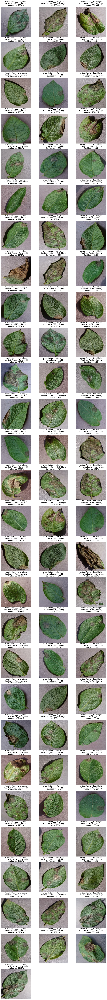

In [14]:
plt.figure(figsize=(15, 5 * lines))
for i in range(num_wrongs):
    ax = plt.subplot(lines, 3, i + 1)

    image, actual_class, predicted_class, confidence = wrong_predictions[i]
    plt.imshow(image.numpy().astype("uint8"))
    
    plt.title(f"Actual: {actual_class},\n Predicted: {predicted_class}.\n Confidence: {confidence}%")
    
    plt.axis("off")